In [ ]:
!unzip dataset.zip


In [62]:
import tensorflow as tf
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications.inception_v3 import preprocess_input
from scipy.linalg import sqrtm
import numpy as np

In [63]:
lam = 200
gen_l = 3e-4
dis_l = 1e-4
EPOCHS = 300


In [64]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_png(img, channels=3)
    img = tf.image.resize(img, [256, 256])  # Resize to 256x256
    img = (img / 127.5) - 1  # Normalize to [-1, 1]
    return img

def load_data(input_dir, output_dir):
    input_images = sorted([os.path.join(input_dir, img) for img in os.listdir(input_dir)])
    output_images = sorted([os.path.join(output_dir, img) for img in os.listdir(output_dir)])

    dataset = tf.data.Dataset.from_tensor_slices((input_images, output_images))

    def map_func(input_path, output_path):
        input_img = load_image(input_path)
        output_img = load_image(output_path)
        return input_img, output_img

    return dataset.map(map_func).batch(16)  # Batch size 16

In [65]:
LAMBDA = lam  # Weight for L1 loss

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_loss = gan_loss + (LAMBDA * l1_loss)
    return total_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_loss = real_loss + generated_loss
    return total_loss

In [66]:
import tensorflow as tf
from tensorflow.keras import layers

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(
        layers.Conv2D(filters, size, strides=2, padding='same',
                      kernel_initializer=initializer, use_bias=False))
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    result.add(layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(
        layers.Conv2DTranspose(filters, size, strides=2,
                               padding='same',
                               kernel_initializer=initializer,
                               use_bias=False))
    result.add(layers.BatchNormalization())
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    result.add(layers.ReLU())
    return result

def Generator():
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (bs, 128, 128, 64)
        downsample(128, 4),  # (bs, 64, 64, 128)
        downsample(256, 4),  # (bs, 32, 32, 256)
        downsample(512, 4),  # (bs, 16, 16, 512)
        downsample(512, 4),  # (bs, 8, 8, 512)
        downsample(512, 4),  # (bs, 4, 4, 512)
        downsample(512, 4),  # (bs, 2, 2, 512)
        downsample(512, 4),  # (bs, 1, 1, 512)
    ]
    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (bs, 8, 8, 1024)
        upsample(512, 4),  # (bs, 16, 16, 1024)
        upsample(256, 4),  # (bs, 32, 32, 512)
        upsample(128, 4),  # (bs, 64, 64, 256)
        upsample(64, 4),  # (bs, 128, 128, 128)
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(3, 4,
                                  strides=2,
                                  padding='same',
                                  kernel_initializer=initializer,
                                  activation='tanh')  # (bs, 256, 256, 3)
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

In [67]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [68]:
import os
import shutil
import random

# Define paths
dataset_path = "dataset"
input_dir = os.path.join(dataset_path, "input")
output_dir = os.path.join(dataset_path, "output")

# Output directories for splits
train_input_dir = os.path.join(dataset_path, "train/input")
train_output_dir = os.path.join(dataset_path, "train/output")
test_input_dir = os.path.join(dataset_path, "test/input")
test_output_dir = os.path.join(dataset_path, "test/output")

# Create directories for train and test sets
os.makedirs(train_input_dir, exist_ok=True)
os.makedirs(train_output_dir, exist_ok=True)
os.makedirs(test_input_dir, exist_ok=True)
os.makedirs(test_output_dir, exist_ok=True)

# Set train-test split ratio
split_ratio = 0.8  # 80% train, 20% test

# Get all files in the input directory
input_files = [f for f in os.listdir(input_dir) if f.startswith("input_")]
input_files.sort()  # Ensure files are sorted to align with output files

# Shuffle files randomly (optional)
random.seed(42)  # For reproducibility
random.shuffle(input_files)

# Calculate split index
split_index = int(len(input_files) * split_ratio)

# Split into train and test
train_files = input_files[:split_index]
test_files = input_files[split_index:]

# Move files to train and test directories
for file in train_files:
    number = file.split("_")[1]  # Extract the number from 'input_<number>'
    shutil.copy(os.path.join(input_dir, file), os.path.join(train_input_dir, file))
    shutil.copy(os.path.join(output_dir, f"output_{number}"), os.path.join(train_output_dir, f"output_{number}"))

for file in test_files:
    number = file.split("_")[1]
    shutil.copy(os.path.join(input_dir, file), os.path.join(test_input_dir, file))
    shutil.copy(os.path.join(output_dir, f"output_{number}"), os.path.join(test_output_dir, f"output_{number}"))

print("Dataset successfully split into train and test sets!")

Dataset successfully split into train and test sets!


In [69]:
generator = Generator()
discriminator = Discriminator()
discriminator.summary()

Model: "functional_119"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_image (InputLayer)  │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ target_image (InputLayer) │ (None, 256, 256, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_83            │ (None, 256, 256, 6)    │              0 │ input_image[0][0],     │
│ (Concatenate)             │                        │                │ target_image[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_105            │ (None, 128, 128, 64)   │          6,144 │ concatenate_83[0][0]   │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_106            │ (None, 64, 64, 128)    │        131,584 │ sequential_105[0][0]   │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sequential_107            │ (None, 32, 32, 256)    │        525,312 │ sequential_106[0][0]   │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_10         │ (None, 34, 34, 256)    │              0 │ sequential_107[0][0]   │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1768 (Conv2D)      │ (None, 31, 31, 512)    │      2,097,152 │ zero_padding2d_10[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1793  │ (None, 31, 31, 512)    │          2,048 │ conv2d_1768[0][0]      │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ leaky_re_lu_71            │ (None, 31, 31, 512)    │              0 │ batch_normalization_1… │
│ (LeakyReLU)               │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ zero_padding2d_11         │ (None, 33, 33, 512)    │              0 │ leaky_re_lu_71[0][0]   │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1769 (Conv2D)      │ (None, 30, 30, 1)      │          8,193 │ zero_padding2d_11[0][… │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 2,770,433 (10.57 MB)

 Trainable params: 2,768,641 (10.56 MB)

 Non-trainable params: 1,792 (7.00 KB)

In [70]:
import random
import glob
import matplotlib.pyplot as plt
import tensorflow as tf

def visualize_progress(generator, input_dir, output_dir, num_images=1):
    """
    Visualize model progress by displaying input images, generated outputs, and ground truths.

    Args:
        generator: The trained generator model.
        input_dir: Directory path containing input images.
        output_dir: Directory path containing ground truth output images.
        num_images: Number of random samples to visualize.
    """
    def preprocess_image(image_path):
        """Load and preprocess an image."""
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image)  # Adjust to your image type (e.g., PNG, JPEG)
        image = tf.image.resize(image, [256, 256])  # Resize to match training dimensions
        image = (image / 127.5) - 1  # Normalize to [-1, 1]
        return tf.expand_dims(image, axis=0)  # Add batch dimension

    def postprocess_output(output):
        """Convert model output to a displayable image."""
        output = (output + 1) * 127.5  # De-normalize to [0, 255]
        output = tf.cast(output, tf.uint8)
        return tf.squeeze(output, axis=0)  # Remove batch dimension

    # Get all input image paths
    input_image_paths = glob.glob(f"{input_dir}/*.png")

    # Randomly select a few input images
    random_image_paths = random.sample(input_image_paths, num_images)

    for test_image_path in random_image_paths:
        # Corresponding ground truth image path
        groundtruth_image_path = test_image_path.replace("/input/", "/output/").replace("input_", "output_")

        # Preprocess the input image
        test_image = preprocess_image(test_image_path)

        # Load and preprocess the ground truth image for display
        groundtruth_image = tf.io.read_file(groundtruth_image_path)
        groundtruth_image = tf.image.decode_image(groundtruth_image)  # Decode to an image array
        groundtruth_image = tf.image.resize(groundtruth_image, [256, 256])  # Resize if needed
        groundtruth_image = groundtruth_image / 255.0  # Normalize to [0, 1] for display

        # Generate the output using the trained generator
        generated_image = generator(test_image, training=False)

        # Postprocess the output
        output_image = postprocess_output(generated_image)

        # Display the input, generated output, and ground truth
        plt.figure(figsize=(15, 5))

        # Input image
        plt.subplot(1, 3, 1)
        plt.title("Input Image")
        plt.imshow(tf.squeeze(test_image, axis=0) * 0.5 + 0.5)  # De-normalize for display
        plt.axis("off")

        # Generated output
        plt.subplot(1, 3, 2)
        plt.title("Generated Output")
        plt.imshow(output_image)
        plt.axis("off")

        # Ground truth image
        plt.subplot(1, 3, 3)
        plt.title("Ground Truth")
        plt.imshow(groundtruth_image)
        plt.axis("off")

        plt.show()

In [71]:
def preprocess_for_inception(images):
    """
    Resize and preprocess images for InceptionV3.

    Args:
        images: Numpy array of images, shape [N, H, W, C].

    Returns:
        Preprocessed images of shape [N, 299, 299, 3].
    """
    images_resized = tf.image.resize(images, [299, 299]).numpy()
    return images_resized

In [72]:
def calculate_fid(real_images, generated_images):
    """
    Calculate Fréchet Inception Distance (FID) between real and generated images.

    Args:
        real_images: Numpy array of real images (ground truth), shape [N, H, W, C].
        generated_images: Numpy array of generated images, shape [N, H, W, C].

    Returns:
        FID score.
    """
    # Load InceptionV3 model (pretrained on ImageNet)
    inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    # Preprocess images for InceptionV3
    real_images = preprocess_input(real_images)
    generated_images = preprocess_input(generated_images)

    # Extract features using InceptionV3
    real_features = inception_model.predict(real_images)
    generated_features = inception_model.predict(generated_images)

    # Calculate mean and covariance of features
    mu_real = real_features.mean(axis=0)
    sigma_real = np.cov(real_features, rowvar=False)
    mu_gen = generated_features.mean(axis=0)
    sigma_gen = np.cov(generated_features, rowvar=False)

    # Compute FID
    diff = mu_real - mu_gen
    covmean = sqrtm(sigma_real @ sigma_gen)

    # Handle numerical issues
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff @ diff + np.trace(sigma_real + sigma_gen - 2 * covmean)
    return fid

In [73]:
@tf.function
def train_step(input_image, target, generator, discriminator, gen_optimizer, disc_optimizer):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Forward pass
        generated_image = generator(input_image, training=True)

        # Discriminator outputs
        real_output = discriminator([input_image, target], training=True)
        fake_output = discriminator([input_image, generated_image], training=True)

        # Loss calculations
        gen_loss = generator_loss(fake_output, generated_image, target)  # Generator loss (e.g., GAN + L1 loss)
        disc_loss = discriminator_loss(real_output, fake_output)         # Discriminator loss

    # Apply gradients
    gen_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    disc_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_optimizer.apply_gradients(zip(gen_gradients, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(disc_gradients, discriminator.trainable_variables))

    # Return losses
    return gen_loss, disc_loss



Epoch 1: Generator Loss = 29.8050, Discriminator Loss = 0.9856
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 1: FID = 11.6488


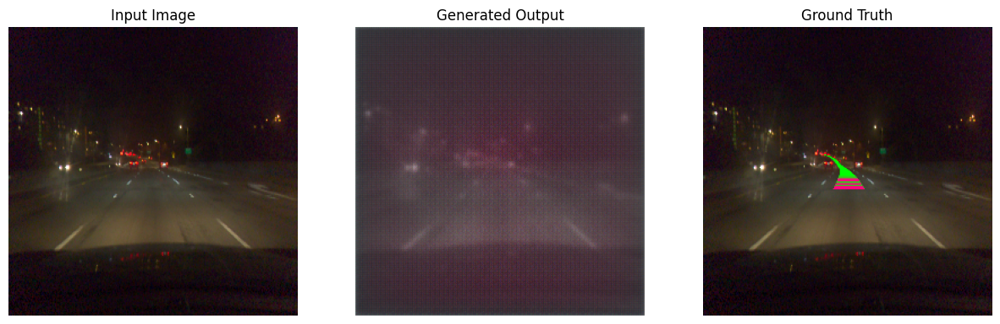

Epoch 2: Generator Loss = 15.1931, Discriminator Loss = 1.1163
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 2: FID = 10.3629


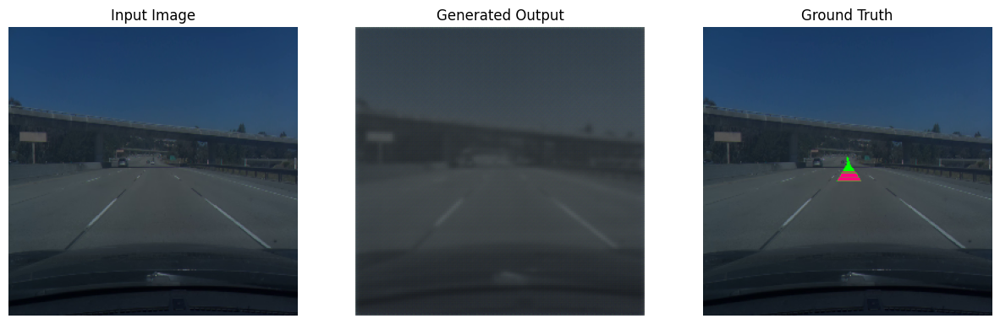

Epoch 3: Generator Loss = 13.6386, Discriminator Loss = 1.0434
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 3: FID = 9.2580


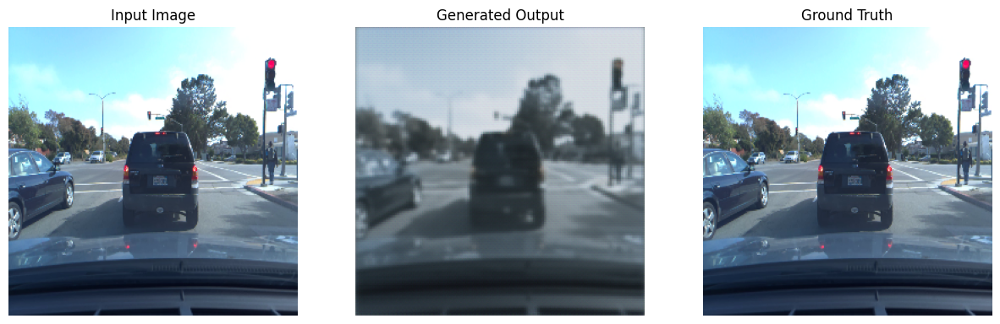

Epoch 4: Generator Loss = 13.1170, Discriminator Loss = 0.8987
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 4: FID = 8.8263


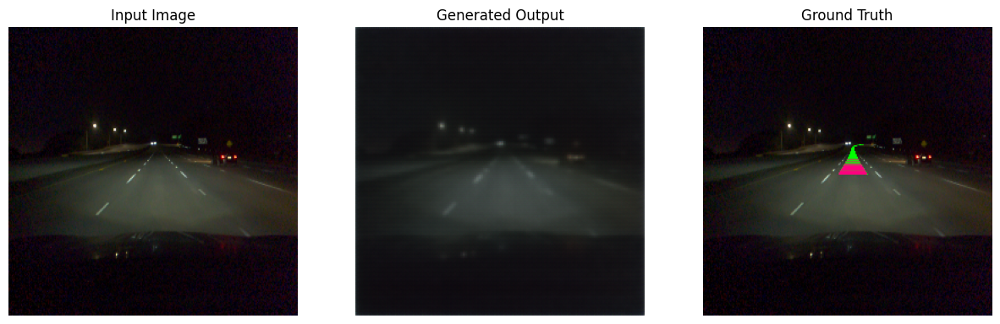

Epoch 5: Generator Loss = 12.9667, Discriminator Loss = 0.9834
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 5: FID = 8.1614


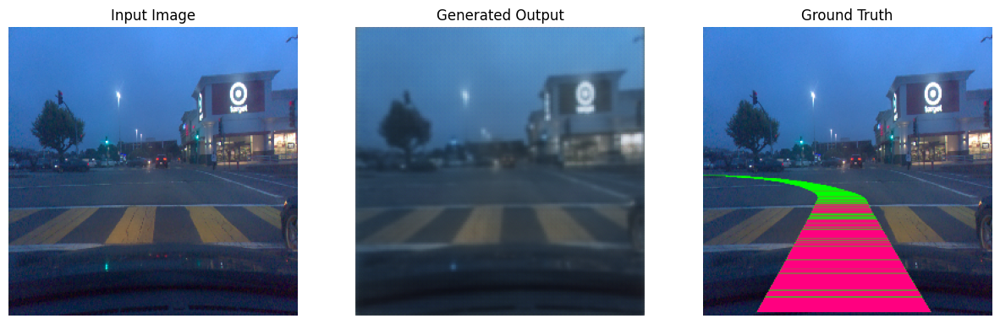

Epoch 6: Generator Loss = 12.4647, Discriminator Loss = 1.0545
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 6: FID = 7.4989


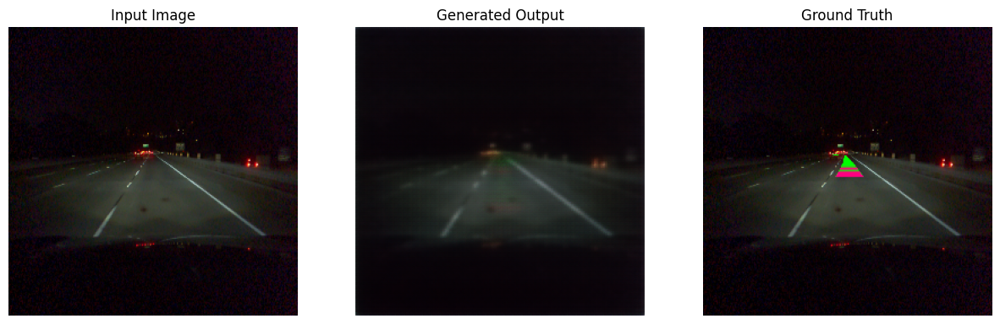

Epoch 7: Generator Loss = 12.3618, Discriminator Loss = 0.8879
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 7: FID = 6.6637


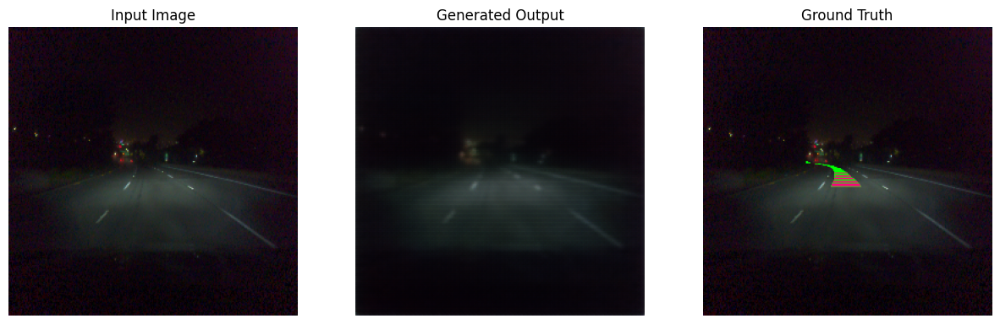

Epoch 8: Generator Loss = 12.2381, Discriminator Loss = 0.8701
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 8: FID = 6.1449


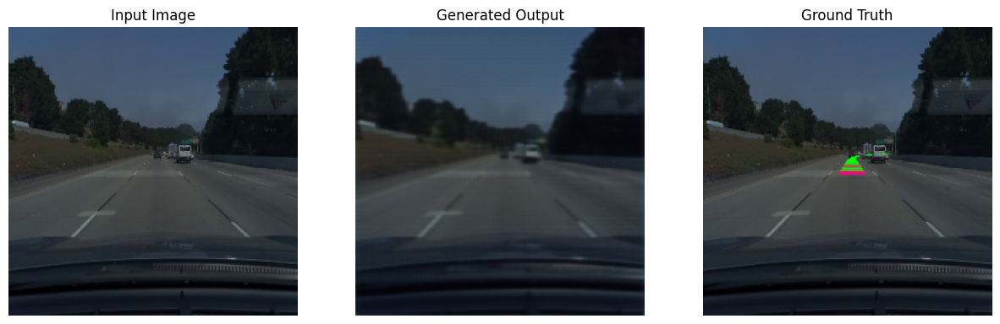

Epoch 9: Generator Loss = 12.1672, Discriminator Loss = 0.8689
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 9: FID = 5.5032


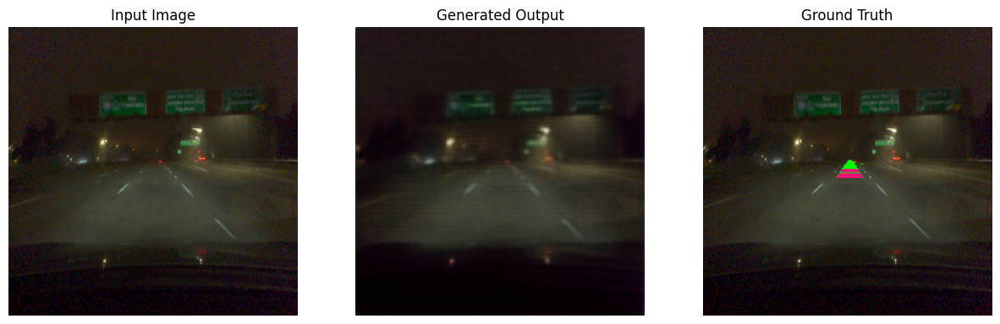

Epoch 10: Generator Loss = 11.9250, Discriminator Loss = 0.8614
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 10: FID = 5.2676


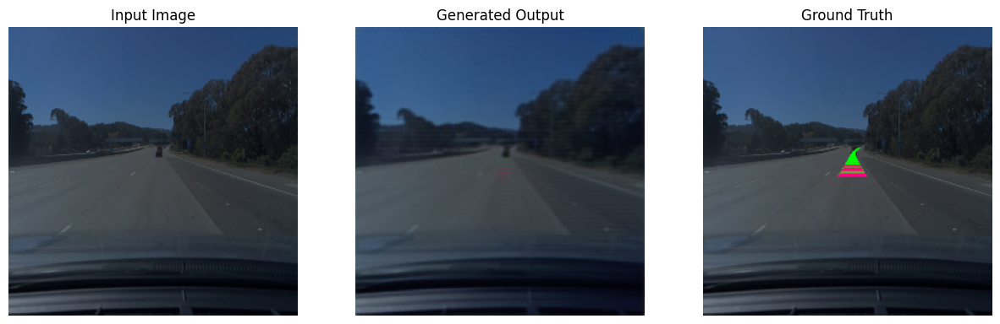

Epoch 11: Generator Loss = 11.7560, Discriminator Loss = 0.8686
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Epoch 11: FID = 4.5984


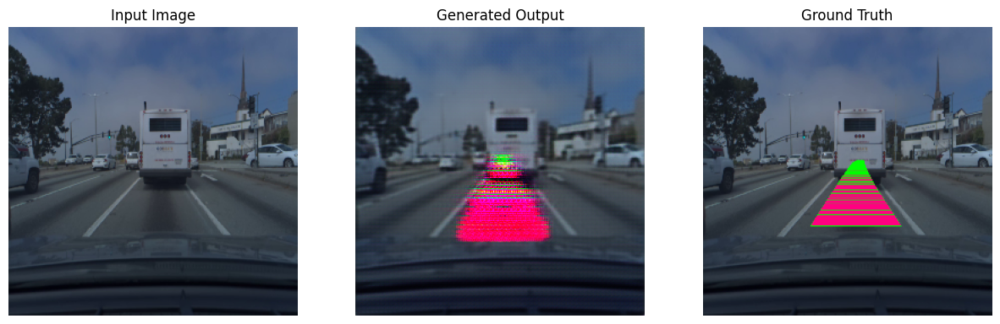

Epoch 12: Generator Loss = 11.3433, Discriminator Loss = 1.0012
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 12: FID = 4.2375


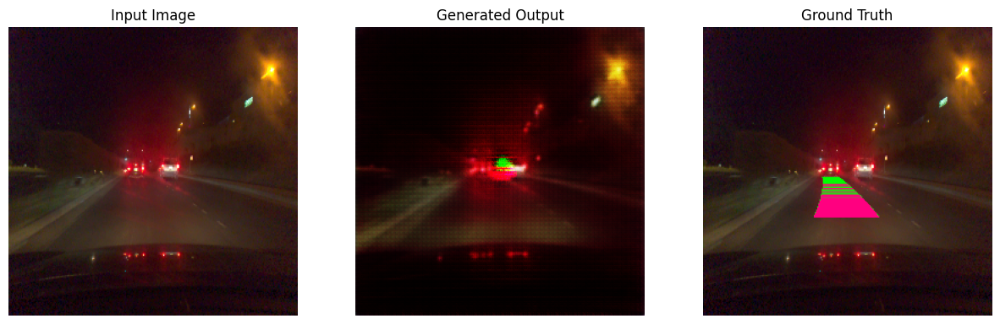

Epoch 13: Generator Loss = 11.1526, Discriminator Loss = 0.9854
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 13: FID = 4.5683


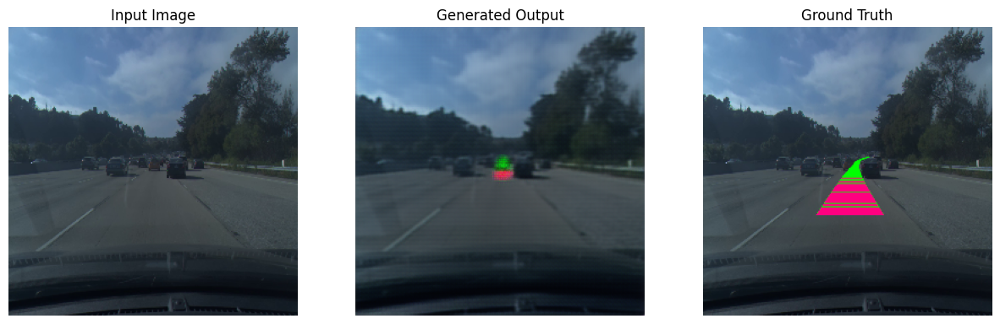

Epoch 14: Generator Loss = 11.0102, Discriminator Loss = 0.9627
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 14: FID = 4.2295


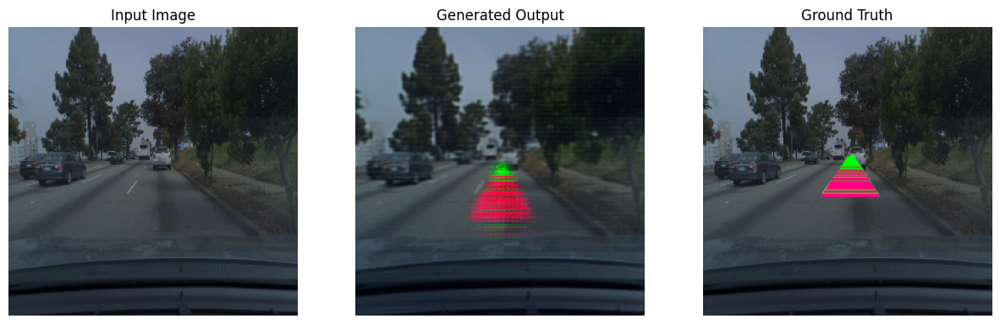

Epoch 15: Generator Loss = 10.8425, Discriminator Loss = 0.9326
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 15: FID = 4.2120


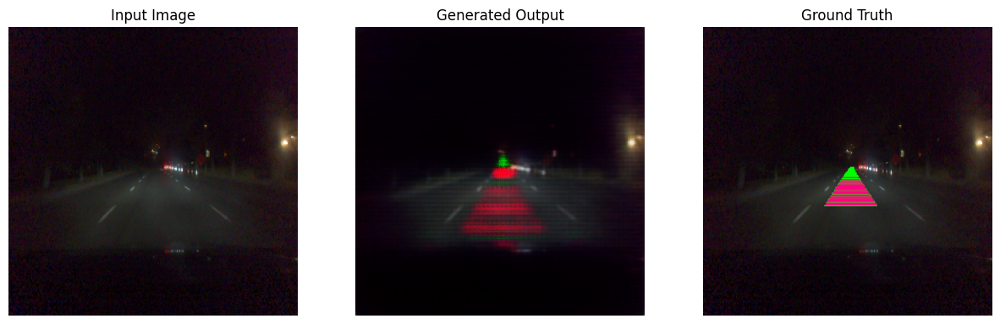

Epoch 16: Generator Loss = 10.6258, Discriminator Loss = 0.9095
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 16: FID = 3.8867


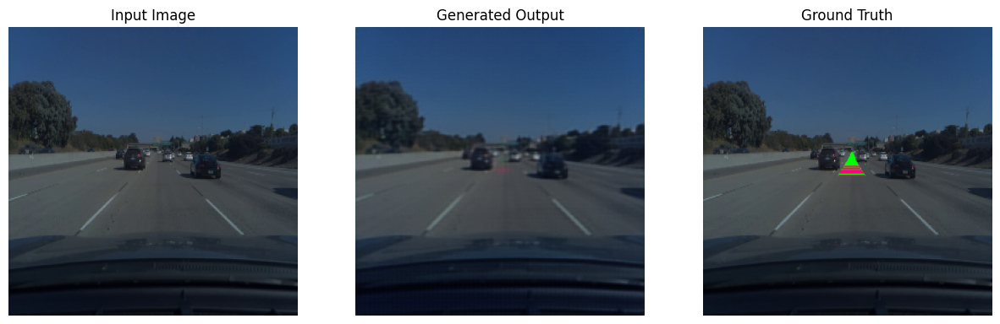

Epoch 17: Generator Loss = 10.7372, Discriminator Loss = 0.9258
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Epoch 17: FID = 4.0224


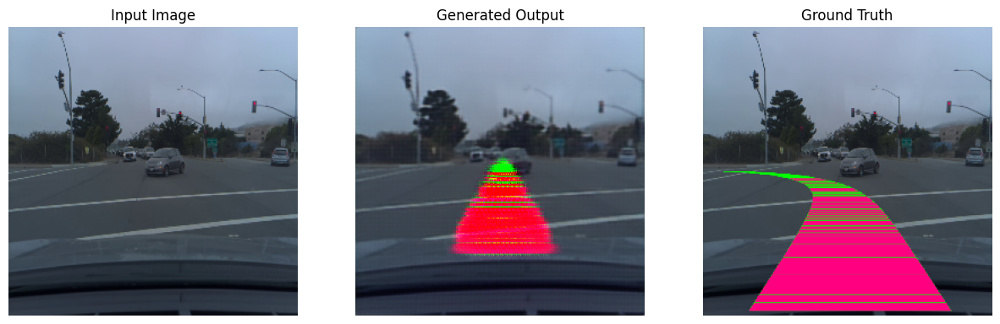

Epoch 18: Generator Loss = 10.5906, Discriminator Loss = 0.9293
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 18: FID = 3.9893


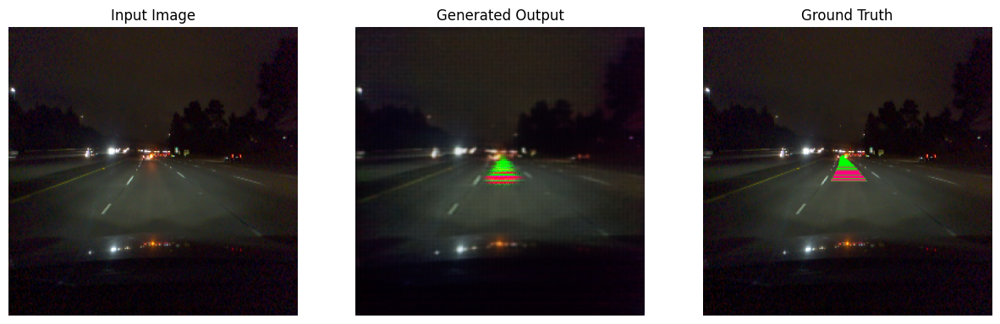

Epoch 19: Generator Loss = 10.3312, Discriminator Loss = 1.0838
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 19: FID = 3.6475


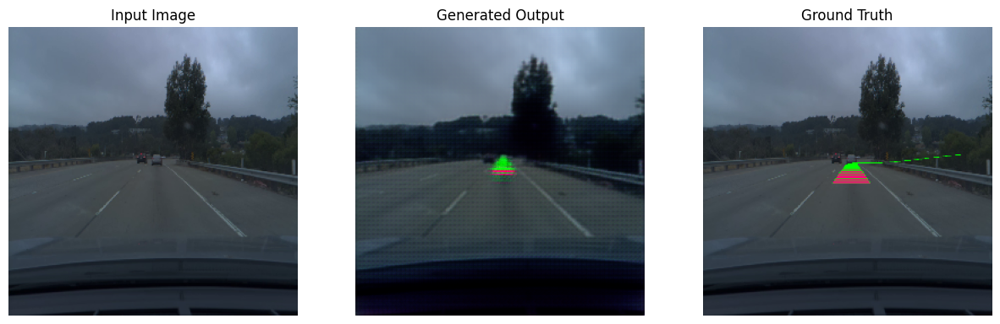

Epoch 20: Generator Loss = 10.0861, Discriminator Loss = 1.1411
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 20: FID = 3.4648


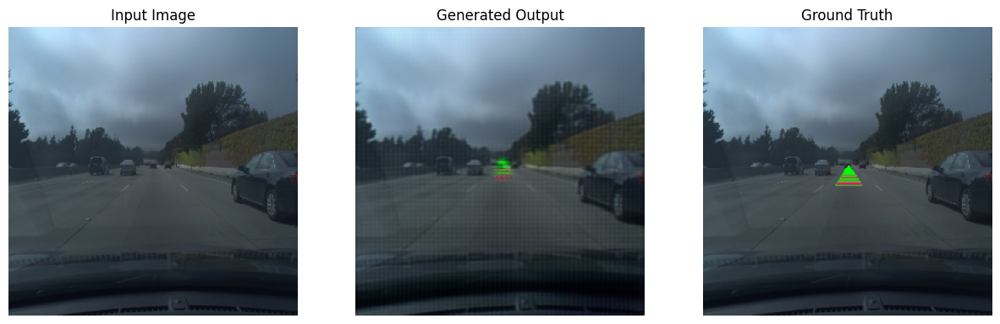

Epoch 21: Generator Loss = 10.2288, Discriminator Loss = 1.1166
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Epoch 21: FID = 3.5955


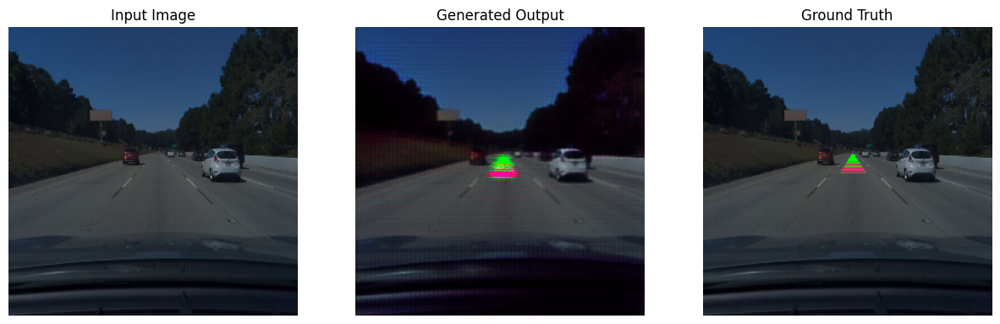

Epoch 22: Generator Loss = 9.9866, Discriminator Loss = 1.0577
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 22: FID = 3.6549


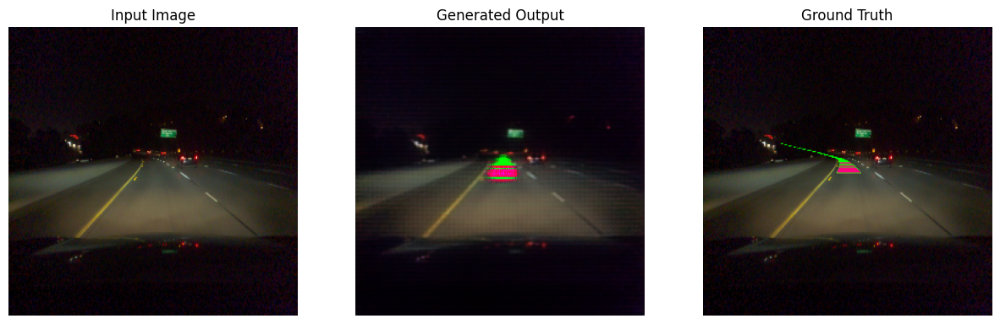

Epoch 23: Generator Loss = 9.7296, Discriminator Loss = 1.0945
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 23: FID = 3.5362


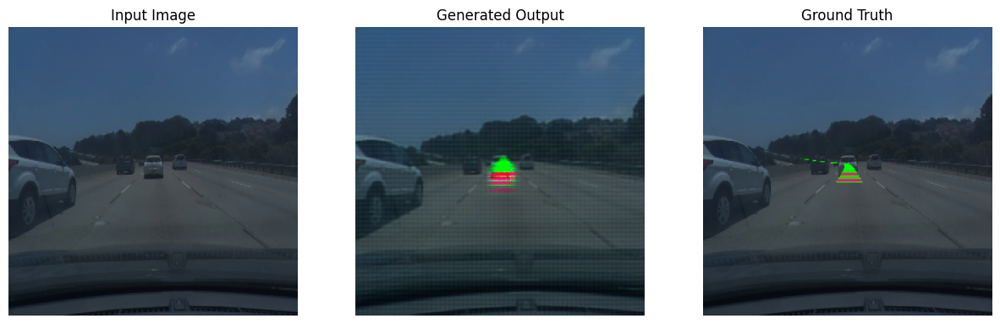

Epoch 24: Generator Loss = 9.7495, Discriminator Loss = 1.0342
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 24: FID = 3.4648


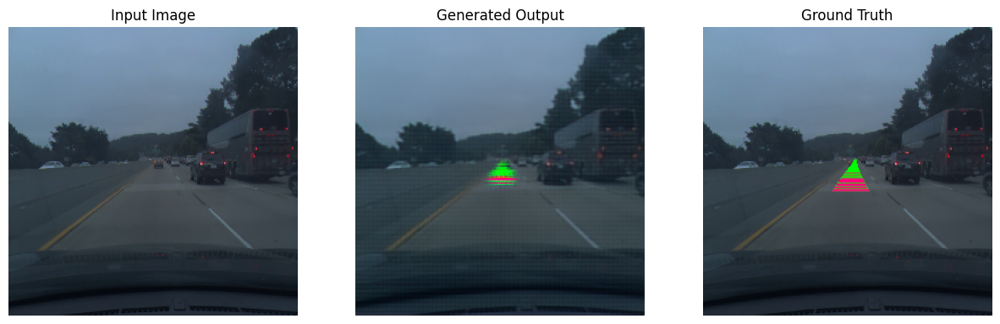

Epoch 25: Generator Loss = 9.3895, Discriminator Loss = 1.0778
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 25: FID = 3.4438


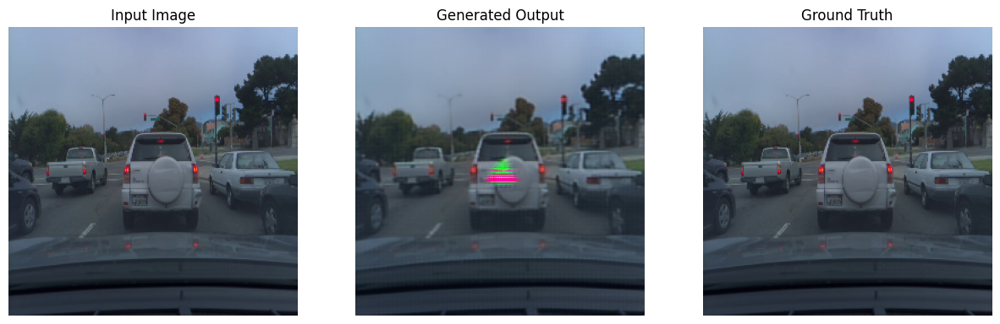

Epoch 26: Generator Loss = 9.2542, Discriminator Loss = 1.0979
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Epoch 26: FID = 3.1023


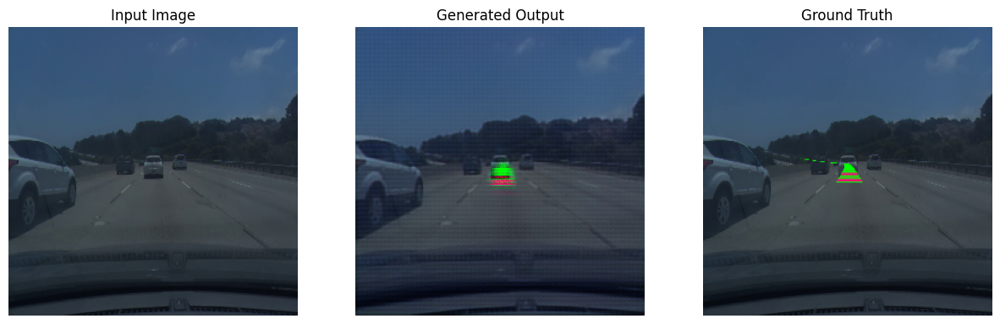

Epoch 27: Generator Loss = 9.3681, Discriminator Loss = 1.0909
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 27: FID = 3.4075


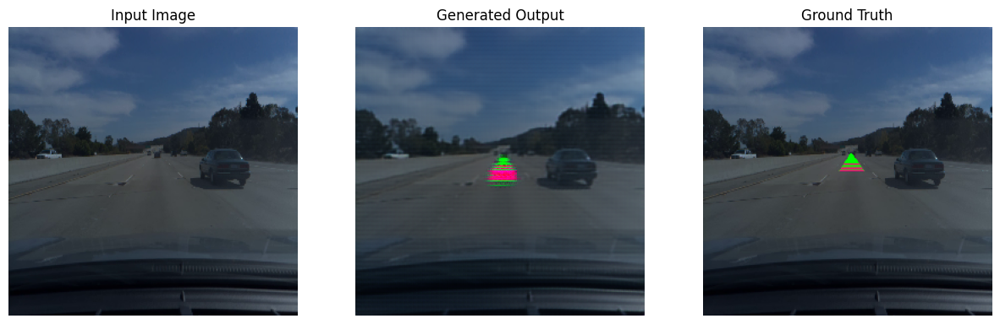

Epoch 28: Generator Loss = 9.3354, Discriminator Loss = 1.0466
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 28: FID = 3.2553


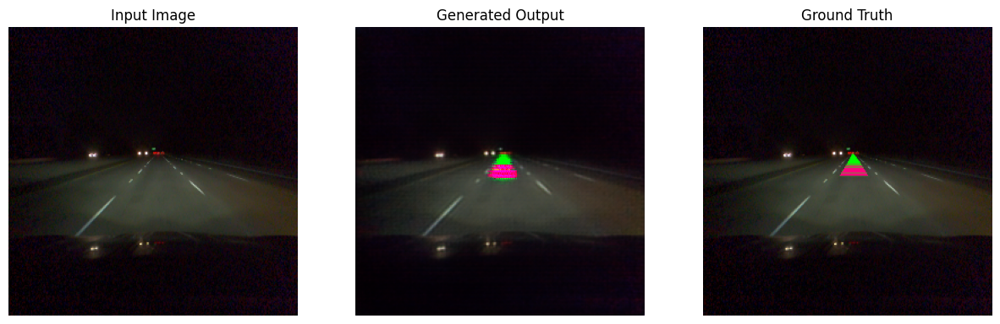

Epoch 29: Generator Loss = 9.0794, Discriminator Loss = 1.0841
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 29: FID = 3.1890


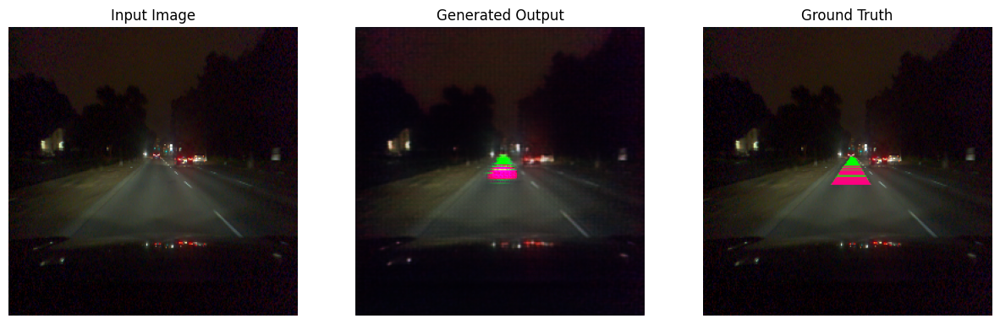

Epoch 30: Generator Loss = 8.9686, Discriminator Loss = 0.9715
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 30: FID = 3.3238


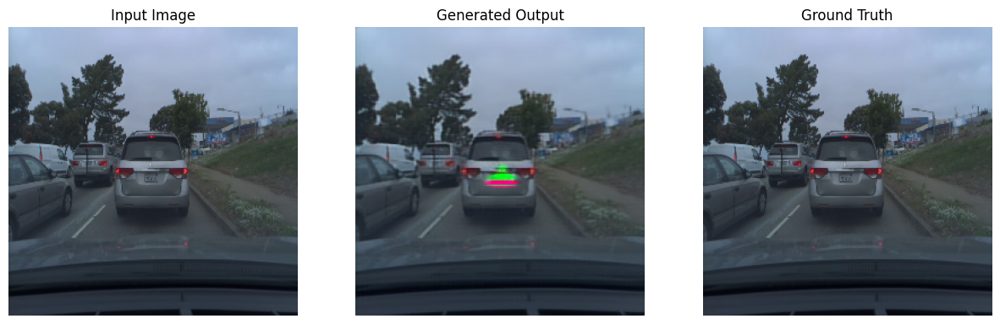

Epoch 31: Generator Loss = 9.2200, Discriminator Loss = 0.9271
1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Epoch 31: FID = 3.0230


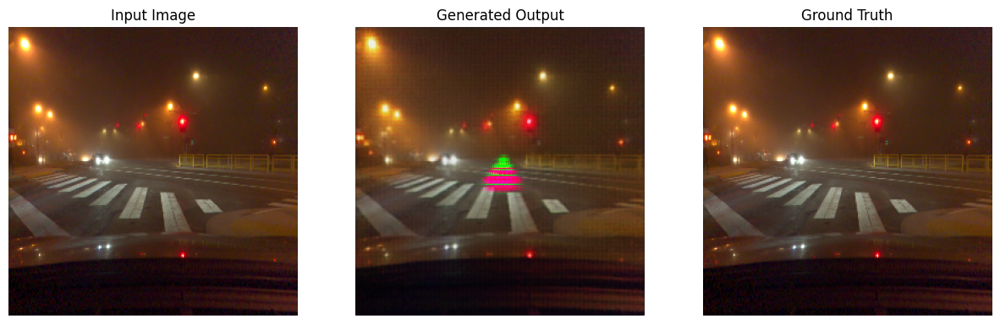

Epoch 32: Generator Loss = 9.0986, Discriminator Loss = 0.9348
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Epoch 32: FID = 3.1970


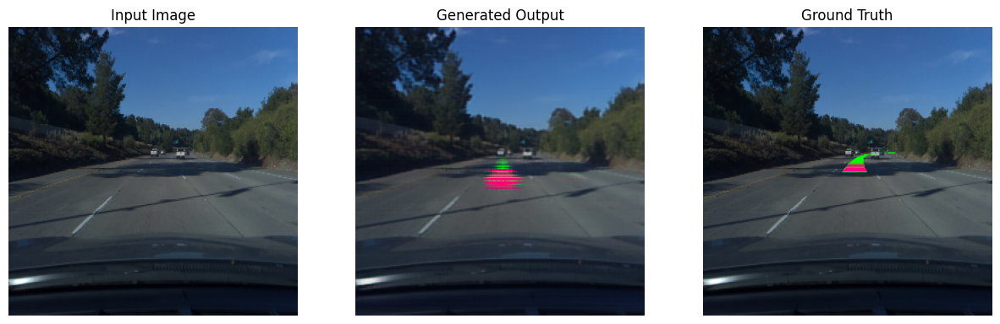

Epoch 33: Generator Loss = 9.0098, Discriminator Loss = 0.9528
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 33: FID = 3.2201


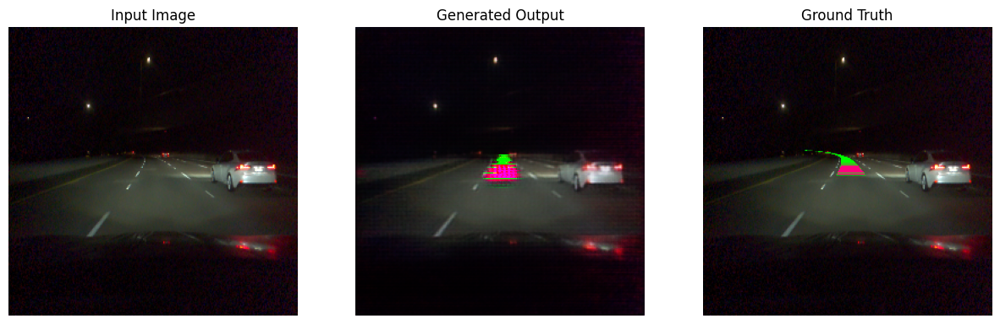

Epoch 34: Generator Loss = 9.1346, Discriminator Loss = 1.0038
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 34: FID = 3.3749


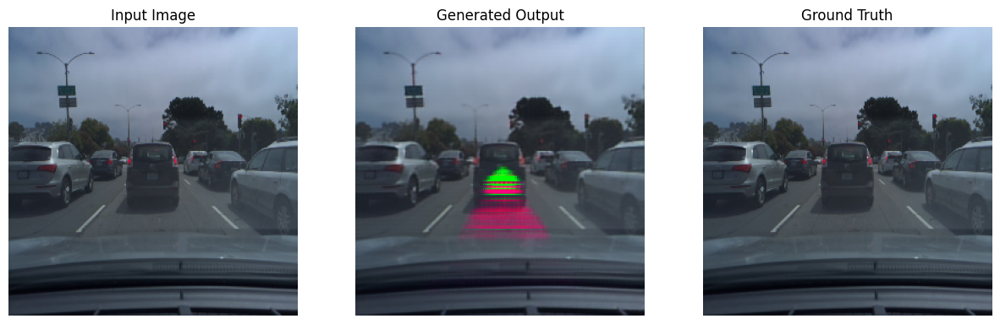

Epoch 35: Generator Loss = 8.8975, Discriminator Loss = 0.9838
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 35: FID = 3.0515


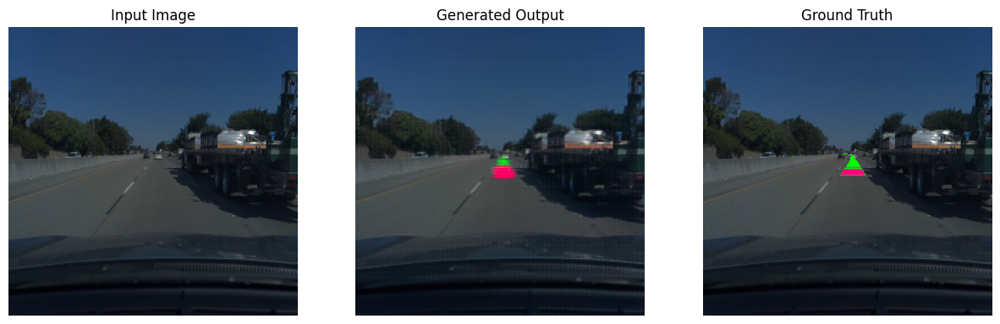

Epoch 36: Generator Loss = 9.0125, Discriminator Loss = 0.8704
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Epoch 36: FID = 2.9819


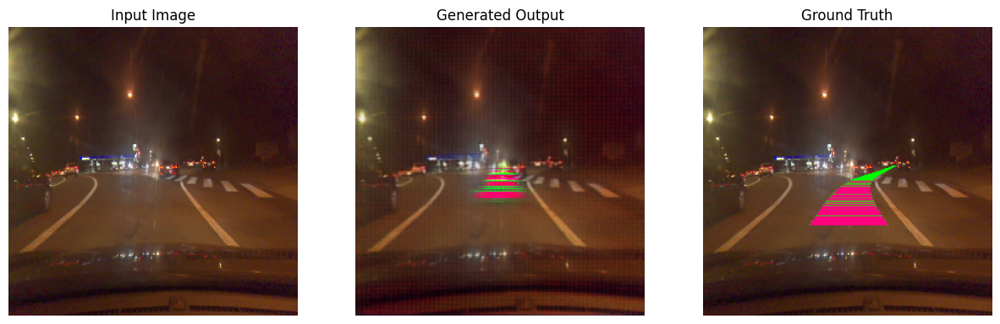

Epoch 37: Generator Loss = 8.7905, Discriminator Loss = 1.0740
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 37: FID = 3.3631


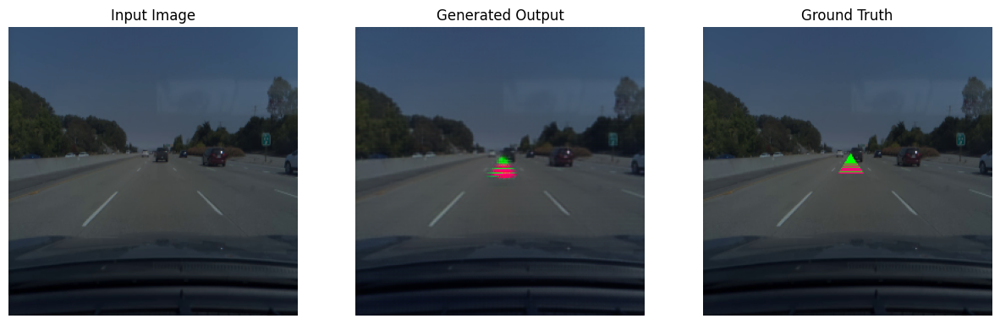

Epoch 38: Generator Loss = 8.6829, Discriminator Loss = 0.9461
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 38: FID = 3.0103


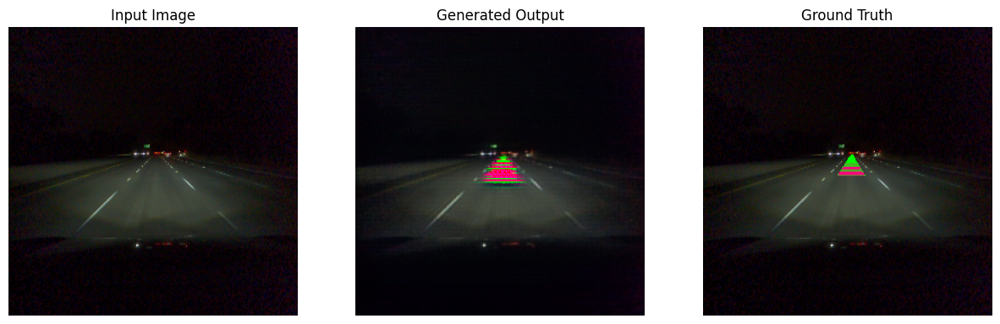

Epoch 39: Generator Loss = 8.8986, Discriminator Loss = 0.9445
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 39: FID = 3.1669


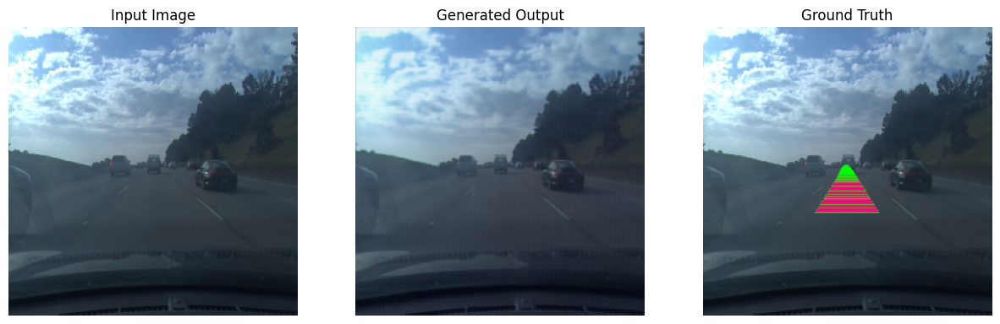

Epoch 40: Generator Loss = 8.8186, Discriminator Loss = 1.0899
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 40: FID = 3.2961


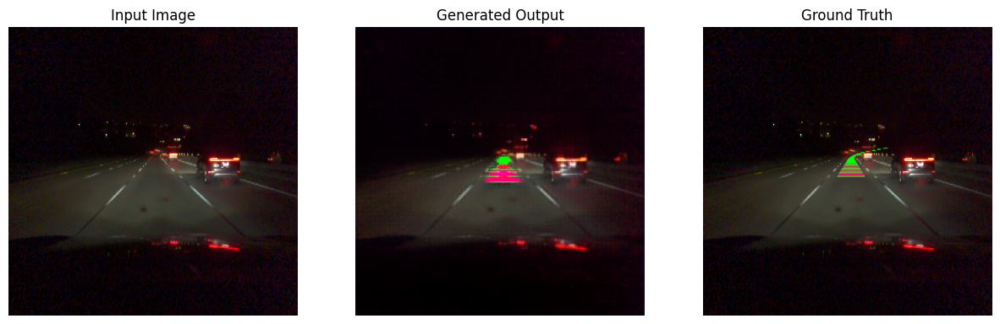

Epoch 41: Generator Loss = 8.5213, Discriminator Loss = 0.9888
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Epoch 41: FID = 3.1389


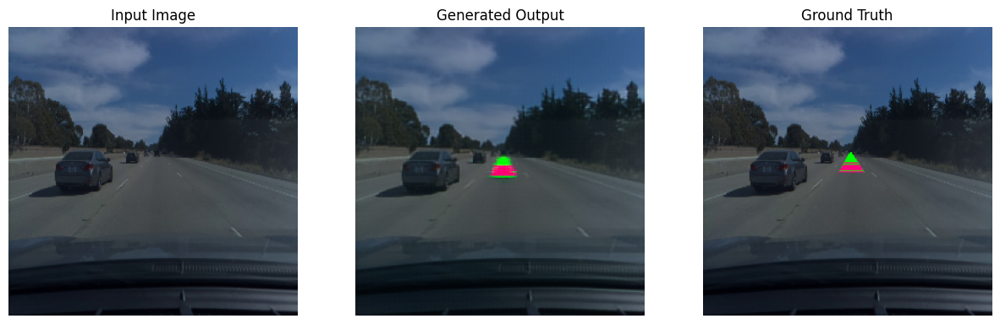

Epoch 42: Generator Loss = 8.5855, Discriminator Loss = 0.9211
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Epoch 42: FID = 2.9223


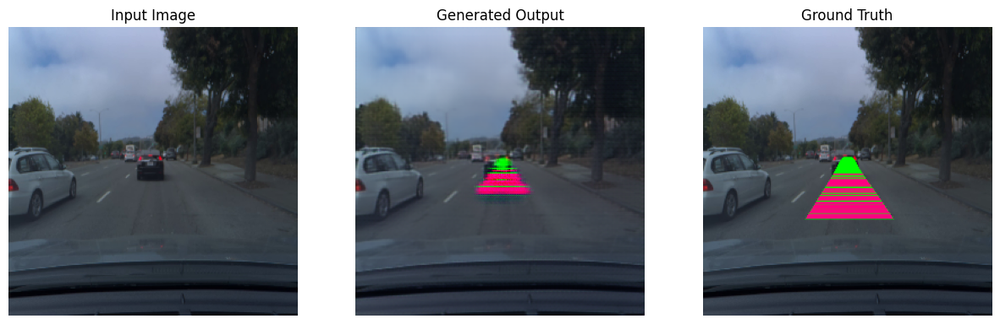

Epoch 43: Generator Loss = 8.5402, Discriminator Loss = 1.0027
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Epoch 43: FID = 2.8918


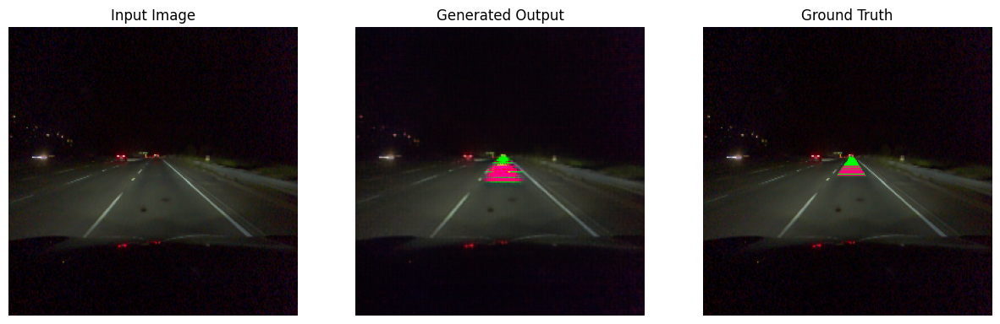

Epoch 44: Generator Loss = 8.0285, Discriminator Loss = 1.0588
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 44: FID = 2.7324


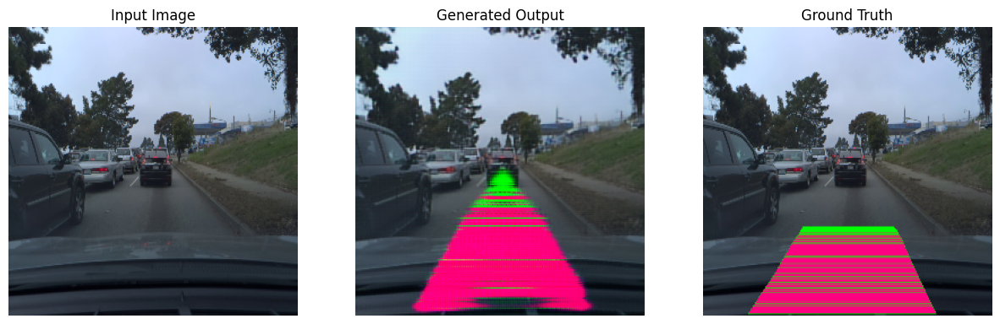

Epoch 45: Generator Loss = 8.3724, Discriminator Loss = 0.9880
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 45: FID = 2.7685


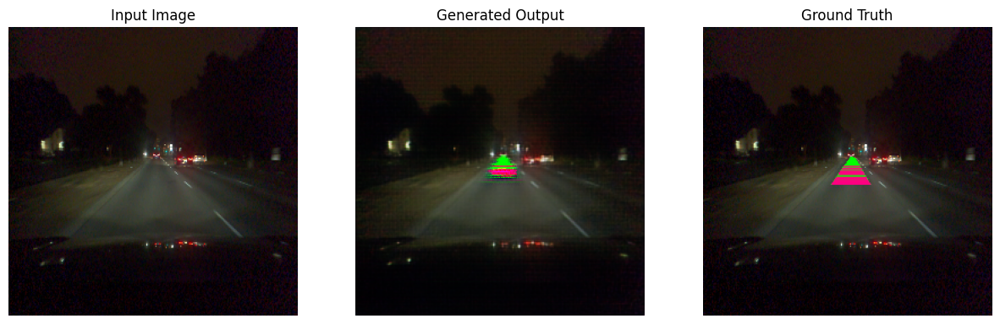

Epoch 46: Generator Loss = 8.4580, Discriminator Loss = 1.0336
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Epoch 46: FID = 2.7886


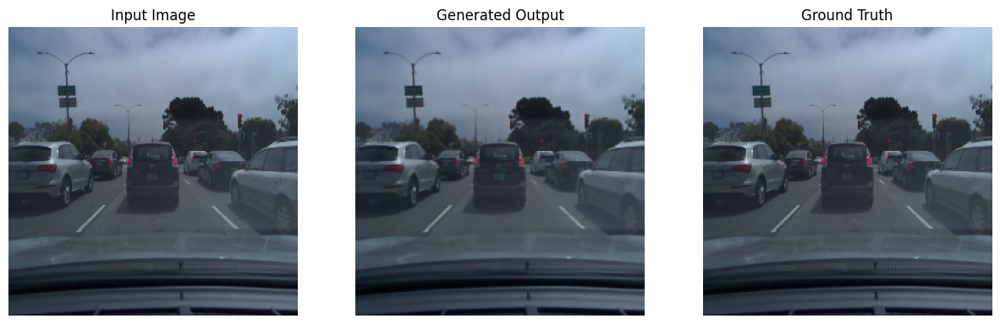

Epoch 47: Generator Loss = 8.2799, Discriminator Loss = 0.9986
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 47: FID = 2.3127


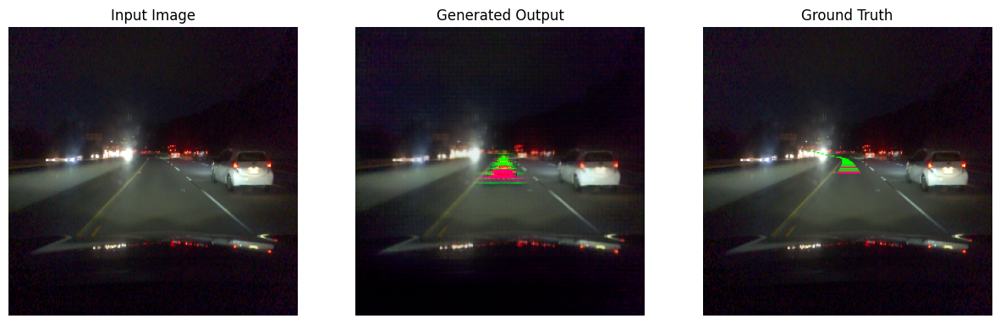

Epoch 48: Generator Loss = 8.5577, Discriminator Loss = 0.9784
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 48: FID = 2.7953


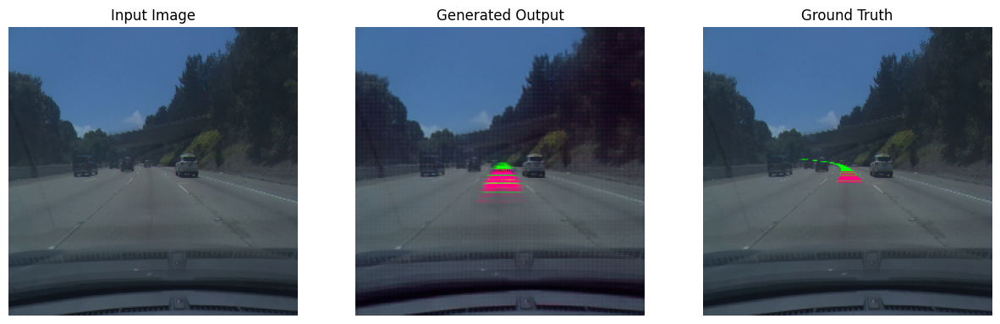

Epoch 49: Generator Loss = 8.2467, Discriminator Loss = 1.0515
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 49: FID = 2.8461


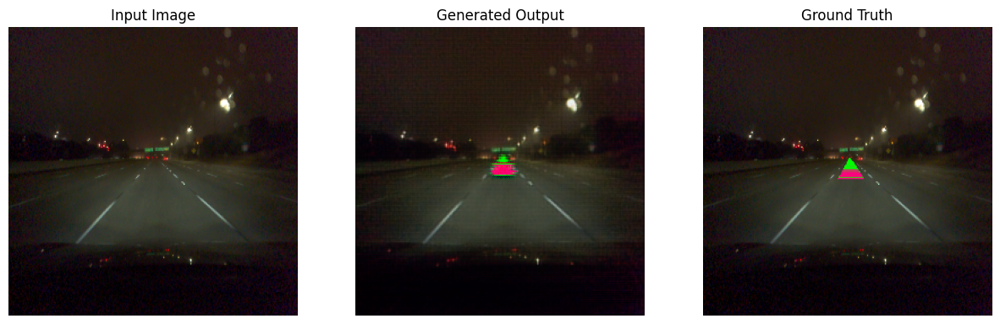

Epoch 50: Generator Loss = 8.3871, Discriminator Loss = 0.9411
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 50: FID = 2.6203


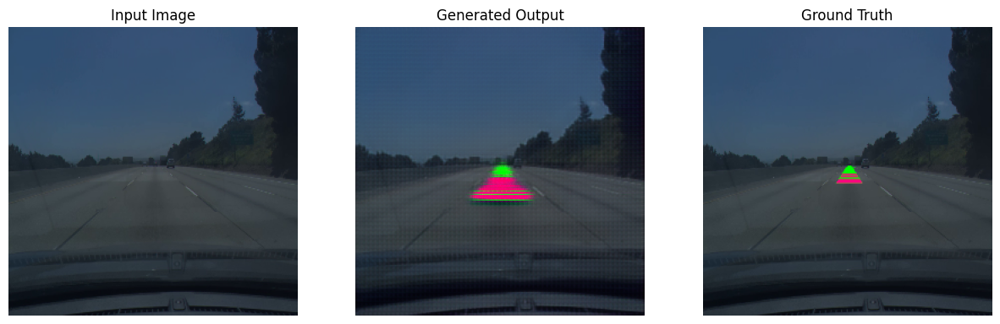

Epoch 51: Generator Loss = 8.3430, Discriminator Loss = 1.0531
1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Epoch 51: FID = 2.5808


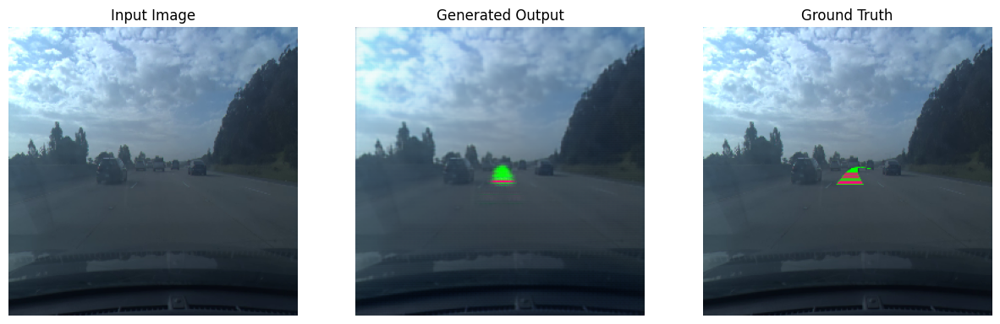

Epoch 52: Generator Loss = 8.6741, Discriminator Loss = 0.9192
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 52: FID = 2.7913


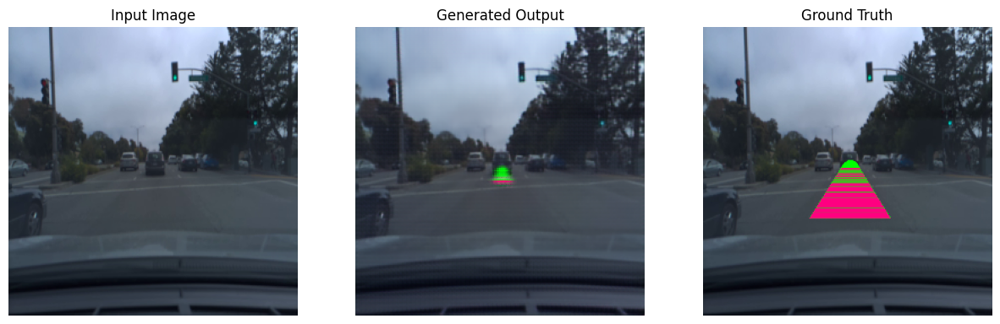

Epoch 53: Generator Loss = 8.4174, Discriminator Loss = 0.9392
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 53: FID = 2.4873


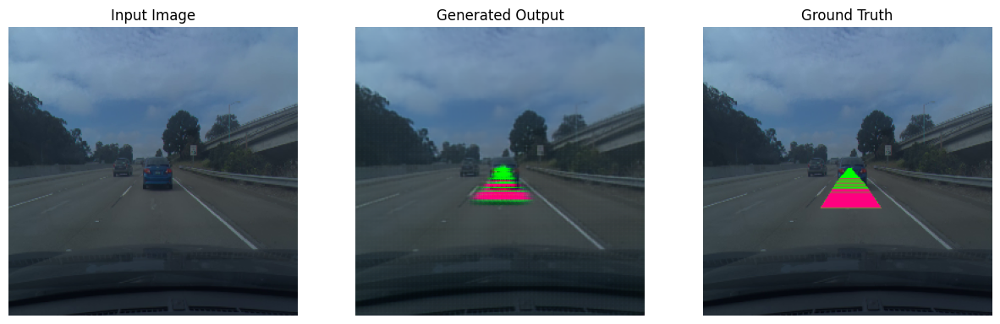

Epoch 54: Generator Loss = 8.2021, Discriminator Loss = 1.0719
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 54: FID = 2.3151


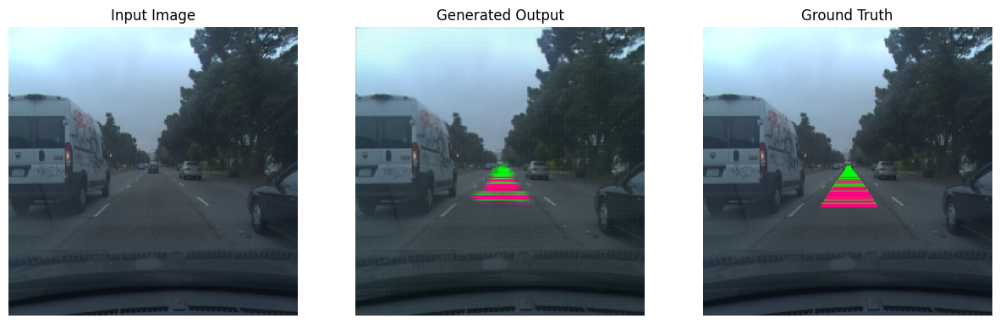

Epoch 55: Generator Loss = 8.0530, Discriminator Loss = 1.0711
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Epoch 55: FID = 2.4067


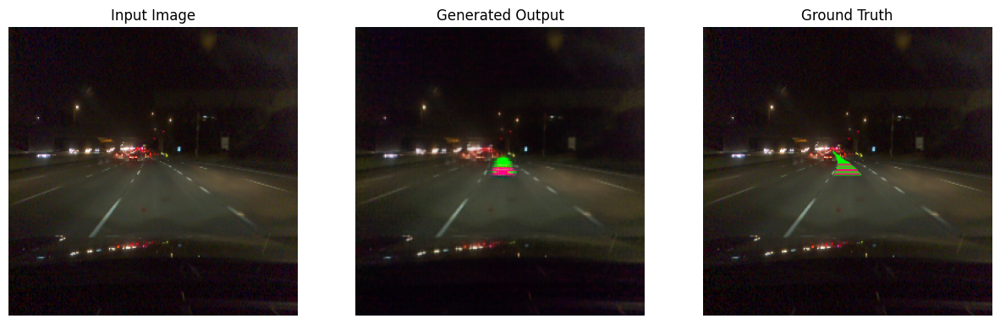

Epoch 56: Generator Loss = 7.8222, Discriminator Loss = 1.1575
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 56: FID = 2.4023


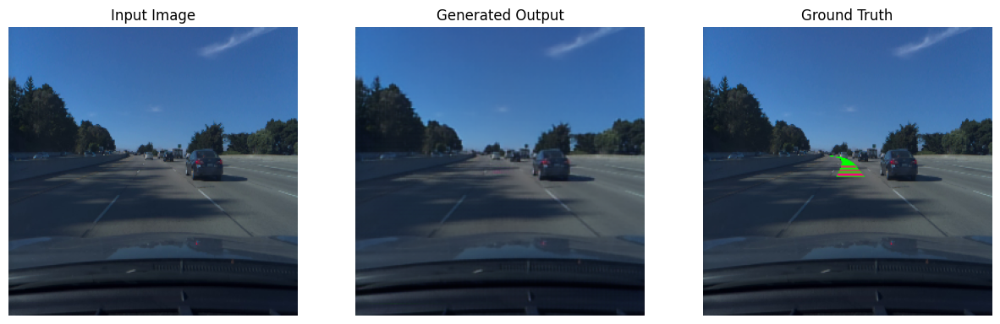

Epoch 57: Generator Loss = 7.7715, Discriminator Loss = 1.0766
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Epoch 57: FID = 2.6826


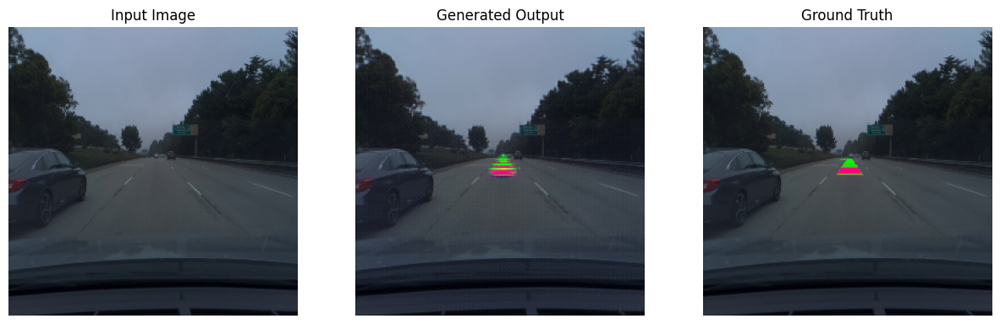

Epoch 58: Generator Loss = 7.8102, Discriminator Loss = 0.9922
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 58: FID = 2.4858


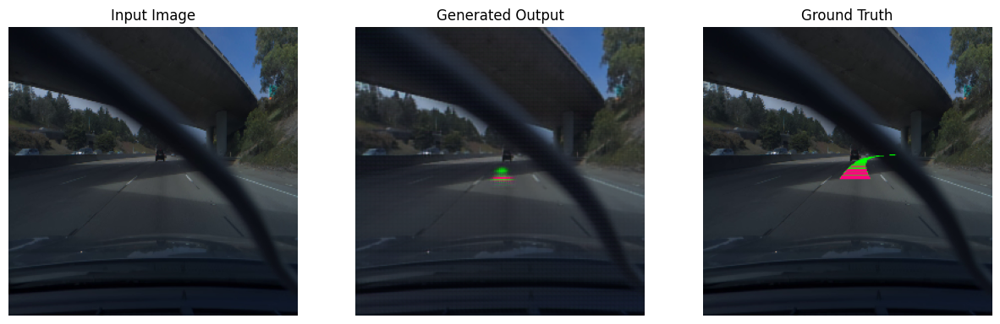

Epoch 59: Generator Loss = 7.9313, Discriminator Loss = 1.0447
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Epoch 59: FID = 2.3965


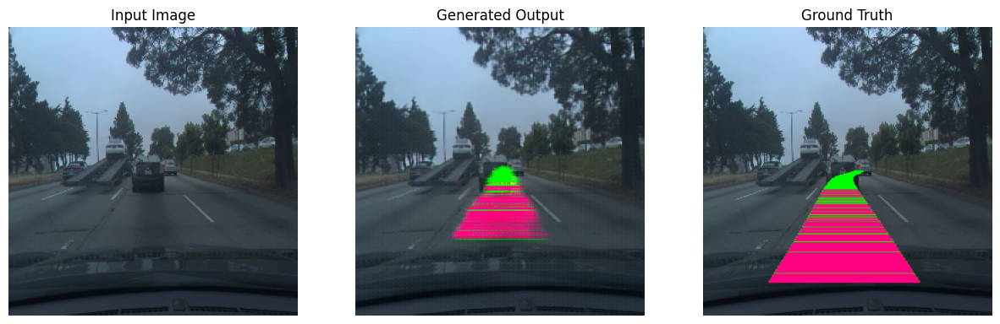

Epoch 60: Generator Loss = 8.0132, Discriminator Loss = 1.0050
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
Epoch 60: FID = 2.3882


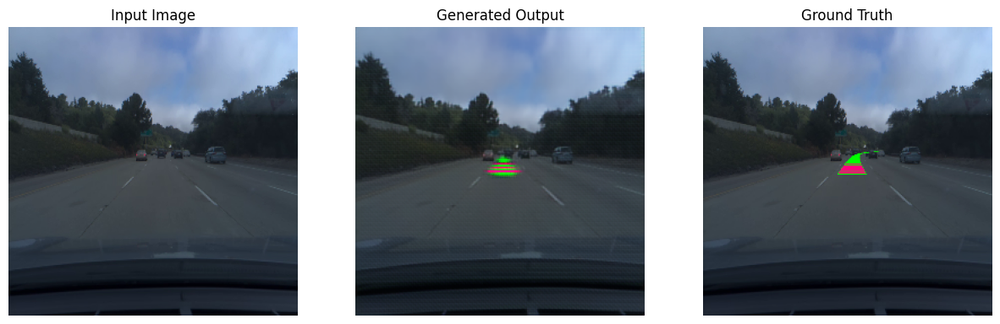

In [ ]:

#generator.load_weights('generator_weights.weights.h5')
#discriminator.load_weights('discriminator_weights.weights.h5')

# Instantiate optimizers
gen_optimizer = tf.keras.optimizers.Adam(gen_l, beta_1=0.5)
disc_optimizer = tf.keras.optimizers.Adam(dis_l, beta_1=0.5)


train_dataset = load_data(train_input_dir, train_output_dir)

# Open a log file for writing
log_file_path = "training_log.txt"

with open(log_file_path, "a") as log_file:  # Use "a" mode to append logs
    for epoch in range(EPOCHS):
        gen_loss_epoch = []
        disc_loss_epoch = []

        for step, (input_image, target) in enumerate(train_dataset):
            gen_loss, disc_loss = train_step(input_image, target, generator, discriminator, gen_optimizer, disc_optimizer)
            gen_loss_epoch.append(gen_loss)
            disc_loss_epoch.append(disc_loss)

        # Epoch-level metrics
        mean_gen_loss = sum(gen_loss_epoch) / len(gen_loss_epoch)
        mean_disc_loss = sum(disc_loss_epoch) / len(disc_loss_epoch)
        epoch_log = f"Epoch {epoch+1}: Generator Loss = {mean_gen_loss:.4f}, Discriminator Loss = {mean_disc_loss:.4f}"
        print(epoch_log)
        log_file.write(epoch_log + "\n")  # Write to log file

        # Generate and preprocess images for FID and IS
        real_images = target[:100].numpy()  # First 100 ground truth images
        generated_images = generator(input_image[:100], training=False).numpy()  # Generate images

        real_images_preprocessed = preprocess_for_inception(real_images)
        generated_images_preprocessed = preprocess_for_inception(generated_images)

        # Compute FID
        fid = calculate_fid(real_images_preprocessed, generated_images_preprocessed)
        fid_log = f"Epoch {epoch+1}: FID = {fid:.4f}"
        print(fid_log)
        log_file.write(fid_log + "\n")  # Write to log file

        # is_mean, is_std = calculate_inception_score(generated_images_preprocessed)
        # is_log = f"Epoch {epoch+1}: IS = {is_mean:.4f} ± {is_std:.4f}"
        # print(is_log)
        # log_file.write(is_log + "\n")  # Write to log file

        # Visualize progress
        visualize_progress(generator, "/content/dataset/input", "/content/dataset/output", num_images=1)

generator.save_weights('generator_weights.weights.h5')  # Added '.weights' to the filename
discriminator.save_weights('discriminator_weights.weights.h5') # Added '.weights' to the filename

In [ ]:
import cv2
import tensorflow as tf
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Load your trained models
generator = Generator()  # Use the same generator architecture
discriminator = Discriminator()  # Use the same discriminator architecture
generator.load_weights('generator_weights.weights.h5')
discriminator.load_weights('discriminator_weights.weights.h5')

# Helper functions (same as your original code)
def preprocess_image(frame):
    """Preprocess a single video frame."""
    frame = tf.image.resize(frame, [256, 256])  # Resize to match training dimensions
    frame = (frame / 127.5) - 1  # Normalize to [-1, 1]
    return tf.expand_dims(frame, axis=0)  # Add batch dimension

def postprocess_output(output):
    """Convert model output to a displayable image."""
    output = (output + 1) * 127.5  # De-normalize to [0, 255]
    output = tf.cast(output, tf.uint8)
    return tf.squeeze(output, axis=0)  # Remove batch dimension

# Read input video
input_video_path = "/content/video.hevc"
output_video_path = "out_video.mp4"

# Open the video file
cap = cv2.VideoCapture(input_video_path)
fps = int(cap.get(cv2.CAP_PROP_FPS))  # Get frames per second
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# Prepare video writer for output
out = cv2.VideoWriter(
    output_video_path,
    cv2.VideoWriter_fourcc(*'mp4v'),  # Codec for MP4
    fps,
    (frame_width, frame_height)
)

print(f"Processing video: {input_video_path}")
print(f"Total frames: {frame_count}, FPS: {fps}")

frame_idx = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # End of video

    frame_idx += 1
    print(f"Processing frame {frame_idx}/{frame_count}...")

    # Convert frame to a TensorFlow tensor and preprocess
    frame_tensor = tf.convert_to_tensor(frame, dtype=tf.float32)
    preprocessed_frame = preprocess_image(frame_tensor)

    # Generate output using the trained model
    generated_frame = generator(preprocessed_frame, training=False)

    # Postprocess the output to convert it back to an image
    output_frame = postprocess_output(generated_frame).numpy()

    # Resize back to original frame size (if necessary)
    output_frame = cv2.resize(output_frame, (frame_width, frame_height))

    # Write the processed frame to the output video
    out.write(output_frame)

# Release resources
cap.release()
out.release()
print(f"Processed video saved to: {output_video_path}")

In [ ]:
import os
import shutil
from datetime import datetime
from google.colab import drive

def save_to_drive(file_path, drive_folder_path):
    """
    Save a file from the Colab session to Google Drive with a timestamped name.

    Args:
        file_path (str): Path to the file in the Colab session to save.
        drive_folder_path (str): Path to the destination folder in Google Drive.
                                (e.g., "My Drive/models")

    Returns:
        str: Full path of the saved file in Google Drive.
    """
    # Mount Google Drive
    drive.mount('/content/drive', force_remount=True)

    # Check if the file exists
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"File not found: {file_path}")

    # Ensure the destination folder exists in Google Drive
    drive_folder_full_path = os.path.join('/content/drive', 'My Drive', drive_folder_path)
    if not os.path.exists(drive_folder_full_path):
        os.makedirs(drive_folder_full_path, exist_ok=True)

    # Generate a timestamped name for the file
    timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
    base_name = os.path.basename(file_path)
    name, ext = os.path.splitext(base_name)
    timestamped_name = f"{name}_{timestamp}{ext}"

    # Create the destination path
    destination_path = os.path.join(drive_folder_full_path, timestamped_name)

    # Copy the file to the destination
    shutil.copy(file_path, destination_path)

    print(f"File saved to Google Drive: {destination_path}")
    return destination_path

In [ ]:
save_to_drive("generator_weights.weights.h5", "models")
save_to_drive("discriminator_weights.weights.h5", "models")
save_to_drive("training_log.txt", "models")
save_to_drive("out_video.mp4", "models")

